In [1]:
import warnings
warnings.filterwarnings('ignore')

In [1]:
!pip3 -q install numpy pandas matplotlib matplotlib seaborn geopy folium datetime scipy sklearn tensorflow

In [18]:
# Importing the Libraries Installed

%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopy.distance

from math import radians,sin,asin,cos,sqrt

import folium
from folium.plugins import HeatMap

import datetime
from scipy.stats import ttest_ind

import matplotlib
matplotlib.rcParams.update({'font.size': 12})


## 1. Loading the Data

In [21]:
uber_data = pd.read_csv('C:/Users/91706/OneDrive/Desktop/Data Science/Uber Trips Analysis/data/uber-raw-data-may14.csv')

In [4]:
# Print the First 10 Elements
display(uber_data.head(10))

,Date/Time,Lat,Lon,Base
0,5/1/2014 0:02:00,40.7521,-73.9914,B02512
1,5/1/2014 0:06:00,40.6965,-73.9715,B02512
2,5/1/2014 0:15:00,40.7464,-73.9838,B02512
3,5/1/2014 0:17:00,40.7463,-74.0011,B02512
4,5/1/2014 0:17:00,40.7594,-73.9734,B02512
5,5/1/2014 0:20:00,40.7685,-73.8625,B02512
6,5/1/2014 0:21:00,40.7637,-73.9962,B02512
7,5/1/2014 0:21:00,40.7252,-74.0023,B02512
8,5/1/2014 0:25:00,40.7607,-73.9625,B02512
9,5/1/2014 0:25:00,40.7212,-73.9879,B02512


### 2 Pre-processing the Data

In [9]:
print(uber_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 652435 entries, 0 to 652434
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  652435 non-null  object 
 1   Lat        652435 non-null  float64
 2   Lon        652435 non-null  float64
 3   Base       652435 non-null  object 
dtypes: float64(2), object(2)
memory usage: 19.9+ MB
None


#### 1. Change the type of the data in Column

In [10]:
# Print the type of Data in Date/Time
print(type(uber_data.loc[0,'Date/Time']))

<class 'str'>


In [11]:
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])

#### 2. Dividing the Data in bins

In [12]:
# Create a column to store this new binned column
uber_data['BinnedHour'] = uber_data['Date/Time'].dt.floor('15min')

In [13]:
# Printing the new column BinnedHour
display(uber_data['BinnedHour'])

0        2014-05-01 00:00:00
1        2014-05-01 00:00:00
2        2014-05-01 00:15:00
3        2014-05-01 00:15:00
4        2014-05-01 00:15:00
                 ...        
652430   2014-05-31 23:45:00
652431   2014-05-31 23:45:00
652432   2014-05-31 23:45:00
652433   2014-05-31 23:45:00
652434   2014-05-31 23:45:00
Name: BinnedHour, Length: 652435, dtype: datetime64[ns]

### 3. Visualizing the Data

#### 1. Let us visualize the total uber rides per day in the month of May 2014

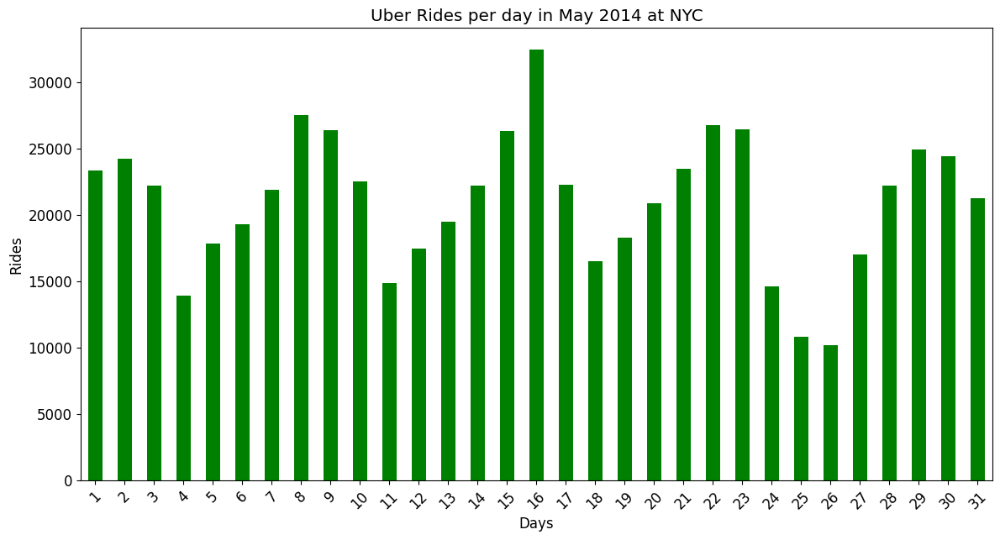

In [14]:
plt.figure(figsize=(14,7))
uber_data['BinnedHour'].dt.day.value_counts().sort_index().plot(kind='bar', color='green')
for item in plt.gca().get_xticklabels():
    item.set_rotation(45)
plt.title('Uber Rides per day in May 2014 at NYC')
plt.xlabel('Days')
plt.ylabel('Rides')
plt.show()

#### Observation 1: There is a recurring pattern in the data! The frequency of trips increases and then decreases in a repeating pattern

#### 2. Let us have a more closer look at it,say every 15 minutes from May 1 to May 31 

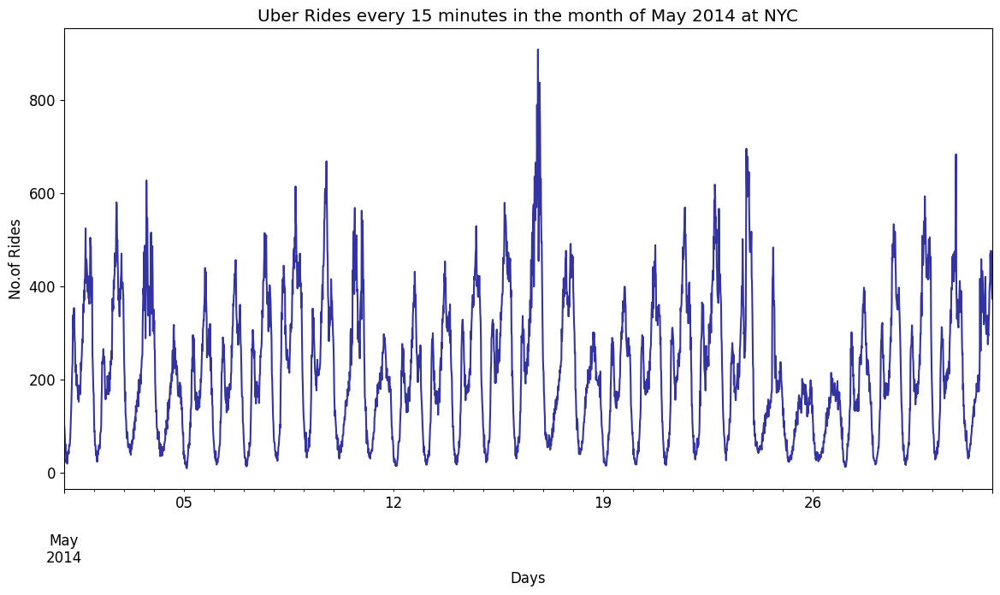

In [15]:
plt.figure(figsize=(14,7))
uber_data['BinnedHour'].value_counts().sort_index().plot(c='darkblue', alpha=0.8)
plt.title('Uber Rides every 15 minutes in the month of May 2014 at NYC')
plt.xlabel('Days')
plt.ylabel('No.of Rides')
plt.show()

#### Observation 2: The underlying trend is clearly visible now. It conveys that in a day there are times when the pickups are very low and very high, and they seem to follow a pattern.

#### Q. Which times correspond to the highest and lowest peaks in the plot above?

In [16]:
display(uber_data['BinnedHour'].value_counts())

BinnedHour
2014-05-16 19:45:00    908
2014-05-16 21:00:00    837
2014-05-16 19:00:00    789
2014-05-16 21:15:00    782
2014-05-16 21:30:00    734
                      ... 
2014-05-07 02:15:00     13
2014-05-27 02:15:00     12
2014-05-05 02:30:00     11
2014-05-05 02:00:00     11
2014-05-05 02:15:00      9
Name: count, Length: 2976, dtype: int64

#### Ans.

The highest peak corresponds to the time 19:45 (7:45 PM), 16th May 2014 and has a ride count of 908 and the lowest peak corresponds to the time 02:15, 5th May 2014 and has a ride count of 9.

### 3. Lets visualize the week wise trend in the data

For this,we have to map each date into its day name using a dictionary

In [17]:
# Defining a dictionary to map the weekday to day name
DayMap = {0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'}
uber_data['Day'] = uber_data['BinnedHour'].dt.weekday.map(DayMap)
display(uber_data['Day'])

0         Thursday
1         Thursday
2         Thursday
3         Thursday
4         Thursday
            ...   
652430    Saturday
652431    Saturday
652432    Saturday
652433    Saturday
652434    Saturday
Name: Day, Length: 652435, dtype: object

In [20]:
# Seperating the date and time to other columns
uber_data['Date'] = uber_data['BinnedHour'].dt.date
uber_data['Time'] = uber_data['BinnedHour'].dt.time
display(uber_data[['Date', 'Time']])

,Date,Time
0,2014-05-01,00:00:00
1,2014-05-01,00:00:00
2,2014-05-01,00:15:00
3,2014-05-01,00:15:00
4,2014-05-01,00:15:00
...,...,...
652430,2014-05-31,23:45:00
652431,2014-05-31,23:45:00
652432,2014-05-31,23:45:00
652433,2014-05-31,23:45:00


In [22]:
# Defining ordered category of week days for easy sorting and visualization
uber_data['Day'] = pd.Categorical(uber_data['Day'],
                                 categories = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],
                                 ordered= True)
display(uber_data['Day'])

0         Thursday
1         Thursday
2         Thursday
3         Thursday
4         Thursday
            ...   
652430    Saturday
652431    Saturday
652432    Saturday
652433    Saturday
652434    Saturday
Name: Day, Length: 652435, dtype: category
Categories (7, object): ['Monday' < 'Tuesday' < 'Wednesday' < 'Thursday' < 'Friday' < 'Saturday' < 'Sunday']

In [23]:
weekly_data = uber_data.groupby(['Date','Day','Time']).count().dropna()\
              .rename(columns={'BinnedHour':'Rides'})['Rides'].reset_index()
weekly_data.head(10)

,Date,Day,Time,Rides
0,2014-05-01,Monday,00:00:00,0
1,2014-05-01,Monday,00:15:00,0
2,2014-05-01,Monday,00:30:00,0
3,2014-05-01,Monday,00:45:00,0
4,2014-05-01,Monday,01:00:00,0
5,2014-05-01,Monday,01:15:00,0
6,2014-05-01,Monday,01:30:00,0
7,2014-05-01,Monday,01:45:00,0
8,2014-05-01,Monday,02:00:00,0
9,2014-05-01,Monday,02:15:00,0


In [25]:
weekly_data['Date'] = pd.to_datetime(weekly_data['Date'])
weekly_data['Day'] = weekly_data['Date'].dt.day_name()

daywise = weekly_data.groupby('Day')['Rides'].sum()
print(daywise)

Day
Friday       133991
Monday        63846
Saturday     102990
Sunday        56168
Thursday     128921
Tuesday       76662
Wednesday     89857
Name: Rides, dtype: int64


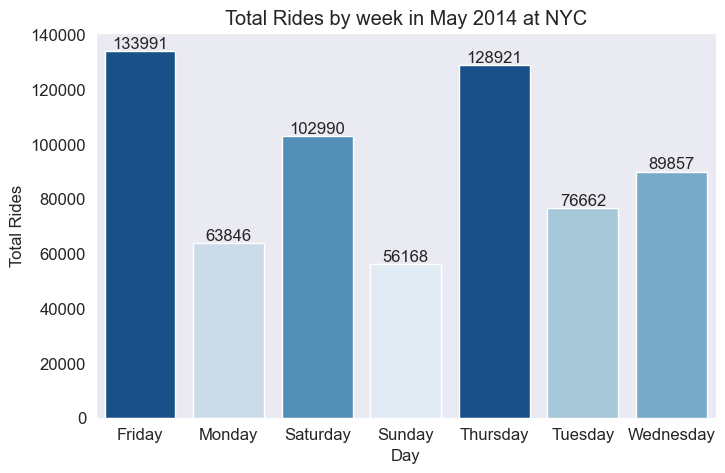

In [28]:
# Plotting the Graphs for better Visualization
sns.set_style("dark")
plt.figure(figsize=(8,5))

# Creating a customized color palette for custom hue according to height of bars
vals = daywise.to_numpy().ravel()
normalized = (vals -np.min(vals)) / (np.max(vals) - np.min(vals))
indices = np.round(normalized * (len(vals)-1)).astype(np.int32)
palette = sns.color_palette('Blues', len(vals))
colorPal = np.array(palette).take(indices, axis =0)

# Creating a bar plot
ax = sns.barplot(x = daywise.index, y= vals, palette=colorPal)
plt.ylabel('Total Rides')
plt.title('Total Rides by week in May 2014 at NYC')
for rect in ax.patches:
    ax.text(rect.get_x() + rect.get_width()/2.0,rect.get_height(), int(rect.get_height()), ha='center', va='bottom')

#### Observation 3: According to the bar plot above, rides are maximum on Fridays and minimum on Sundays. Sundays having the lowest number of rides makes sense logically, as it's a holiday and people often take rest on that day.

In [29]:
weekly_data = weekly_data.groupby(['Day','Time']).mean()['Rides']
display(weekly_data.head(10))

Day     Time    
Friday  00:00:00    18.000000
        00:15:00    15.000000
        00:30:00    13.285714
        00:45:00    10.971429
        01:00:00    10.142857
        01:15:00     8.971429
        01:30:00     6.571429
        01:45:00     7.342857
        02:00:00     6.200000
        02:15:00     5.457143
Name: Rides, dtype: float64

In [30]:
# Unstacking the data to create HeatMap
weekly_data = weekly_data.unstack(level=0)
display(weekly_data)

Day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
Time,,,,,,,
00:00:00,18.000000,8.821429,35.257143,43.928571,12.542857,8.321429,10.642857
00:15:00,15.000000,7.071429,30.371429,41.428571,10.628571,6.392857,8.000000
00:30:00,13.285714,5.357143,25.142857,34.500000,8.314286,6.142857,6.107143
00:45:00,10.971429,6.142857,20.028571,31.821429,9.257143,4.678571,5.178571
01:00:00,10.142857,4.607143,19.542857,27.321429,7.200000,4.428571,4.892857
...,...,...,...,...,...,...,...
22:45:00,62.257143,18.678571,59.514286,17.500000,40.457143,24.392857,27.892857
23:00:00,55.457143,16.071429,57.514286,15.464286,33.885714,20.750000,22.107143
23:15:00,52.028571,12.678571,53.857143,14.035714,30.028571,15.892857,20.357143


Text(0.5, 1.0, 'Heatmap of average rides in time vs. day grid')

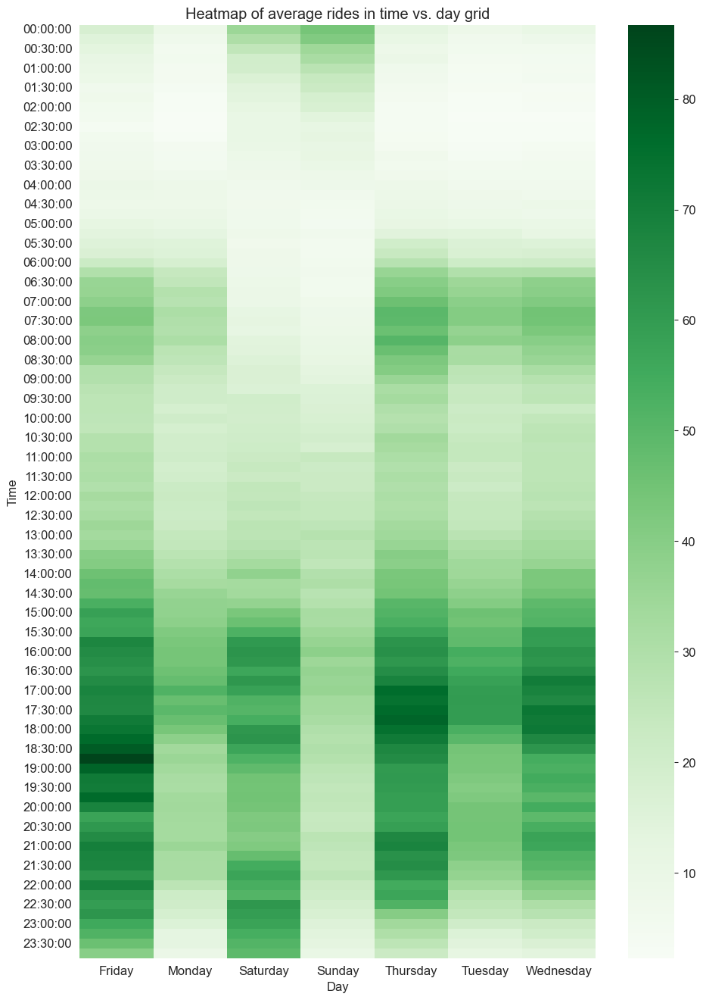

In [34]:
plt.figure(figsize=(11,16))
sns.heatmap(weekly_data, cmap="Greens")
plt.title('Heatmap of average rides in time vs. day grid')

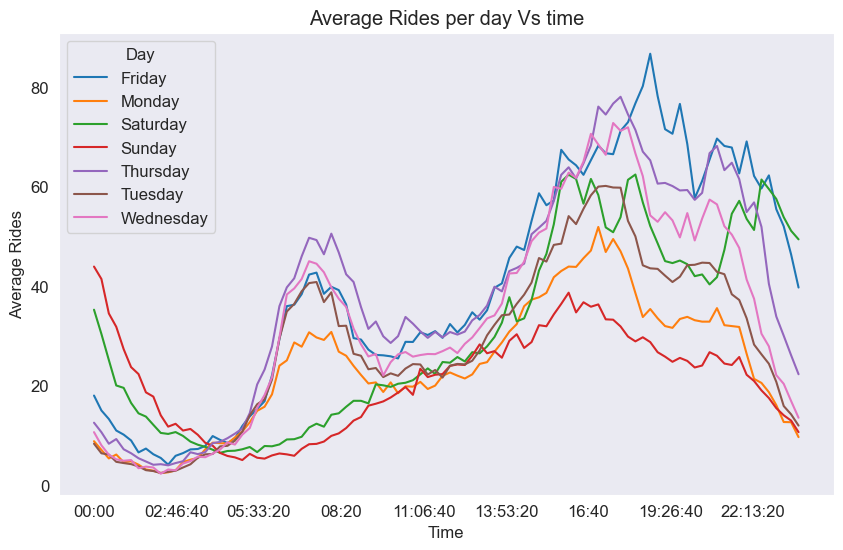

In [35]:
plt.figure(figsize=(10,6))
weekly_data.plot(ax=plt.gca())
plt.title('Average Rides per day Vs time')
plt.ylabel('Average Rides')
plt.locator_params(axis='x', nbins=10)
plt.show()

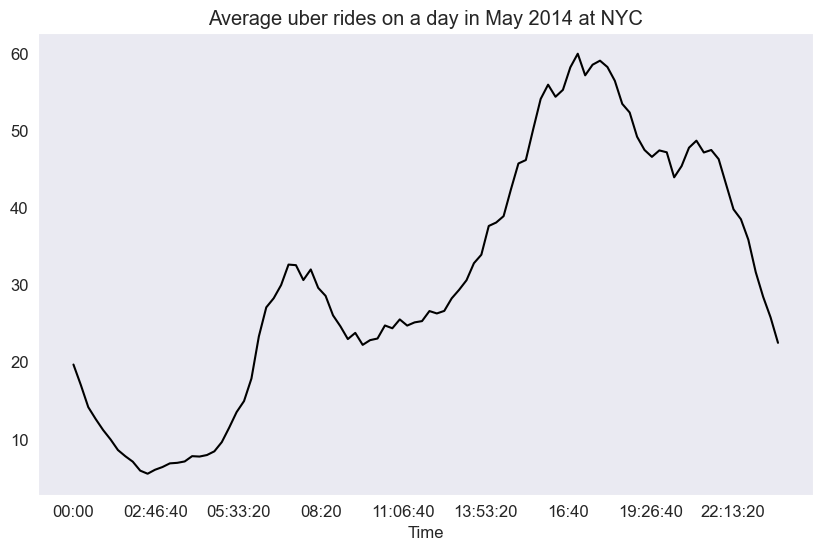

In [36]:
plt.figure(figsize=(10,6))
weekly_data.T.mean().plot(c = 'black')
plt.title('Average uber rides on a day in May 2014 at NYC')
plt.locator_params(axis ='x', nbins=10)
plt.show()

#### Observation 4: This plot further confirms that the average rides on any given day is lowest around 2 AM and highest in the around 4:30 PM.

#### 4. Let's visualise the relationship between Base and total number of rides in May 2014.

In [37]:
# A MApper to map base number with its name
BaseMapper = {'B02512' : 'Unter', 'B02598' : 'Hinter', 'B02617' : 'Weiter', 'B02682' : 'Schmecken',
              'B02764' : 'Danach-NY'}

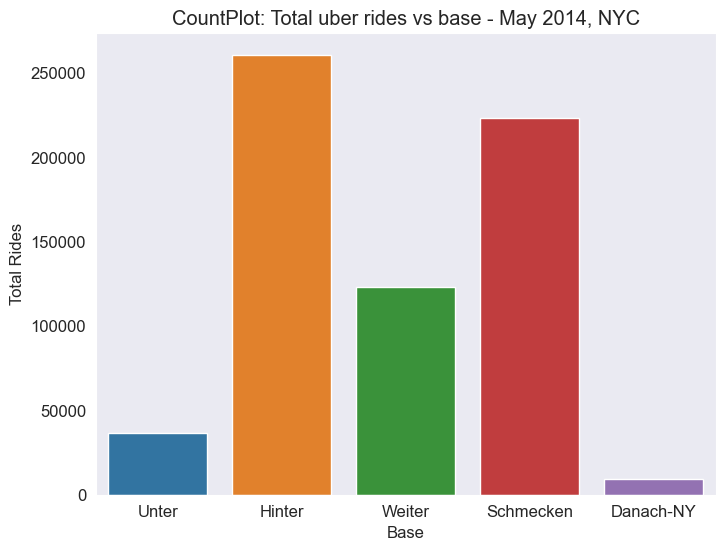

In [41]:
# Count plot of Base
plt.figure(figsize=(8,6))
sns.set_style("dark")
sns.countplot(x=uber_data['Base'].map(BaseMapper))
plt.ylabel('Total Rides')
plt.title('CountPlot: Total uber rides vs base - May 2014, NYC')
plt.show()

#### Observation 5: The above plot tells us that most uber rides originated from Hinter and least from Danach-NY.

#### 5. Now let's make use of latitude and longitude data to see how the uber trips' frequency is distributed across NYC.

We will need some center of city to act as origin and we will plot the rest of the coordinates around it.

For the example given below, we consider the center as Metropolitan Museum in NYC, whose coordinates are metro_art_coordinates = (40.7794,-73.9632).

In [43]:
metro_art_coordinates = (40.7794,-73.9632)

In [46]:
# Initilize the map around NYC and set the zoom level to 10
uber_map = folium.Map(location=metro_art_coordinates, zoom_start=10)

# Lets mark MM on the map
folium.Marker(metro_art_coordinates, popup= "Metropolitan Museum").add_to(uber_map)

# Convert to numpy array and plot it
Lat_Lon = uber_data[['Lat','Lon']].to_numpy()
folium.plugins.HeatMap(Lat_Lon, radius =10).add_to(uber_map)

# Displaying the map
display(uber_map)

We can observe that the boundaries and the intensity distribution of the heatmap on the map is not clear. To fix this, we reduce the intensity of each point on the heatmap by using a weight of 0.5 (by default it is 1).

In [47]:
uber_data['Weight'] = 0.5

Lat_Lon = uber_data[['Lat','Lon','Weight']].to_numpy()

# Plotting
uber_map = folium.Map(metro_art_coordinates, zoom_start =10)
folium.Marker(metro_art_coordinates, popup = "Metropolitan Museum").add_to(uber_map)
folium.plugins.HeatMap(Lat_Lon, radius = 15).add_to(uber_map)

# Displaying the map
display(uber_map)

#### 6. Let's visualize the timed data of trips, as a time lapse on a map!

In [48]:
# Create a copy of the Data
map_data = uber_data.copy()

# Use a smaller WEight
map_data['Weight'] = 0.4

# Generate samples for each timestamp in "BinnedHour" (these are the points that are plotted for each timestamp)
map_data = map_data.groupby("BinnedHour").apply(lambda x: x[['Lat','Lon','Weight']]
                                               .sample(int(len(x)/3)).to_numpy().tolist())

In [49]:
display(map_data)

BinnedHour
2014-05-01 00:00:00    [[40.7487, -74.0035, 0.4], [40.7517, -74.0058,...
2014-05-01 00:15:00    [[40.644, -73.7827, 0.4], [40.7497, -73.9856, ...
2014-05-01 00:30:00    [[40.7494, -73.9918, 0.4], [40.7217, -74.0043,...
2014-05-01 00:45:00    [[40.7217, -74.0041, 0.4], [40.7647, -73.7715,...
2014-05-01 01:00:00    [[40.6449, -73.7822, 0.4], [40.6444, -73.7818,...
                                             ...                        
2014-05-31 22:45:00    [[40.7253, -73.9843, 0.4], [40.7443, -73.9806,...
2014-05-31 23:00:00    [[40.7368, -74.0021, 0.4], [40.7331, -74.0004,...
2014-05-31 23:15:00    [[40.7197, -74.0102, 0.4], [40.7201, -73.9936,...
2014-05-31 23:30:00    [[40.7457, -74.0073, 0.4], [40.7308, -73.9929,...
2014-05-31 23:45:00    [[40.7409, -74.0075, 0.4], [40.7278, -73.9838,...
Length: 2976, dtype: object

In [50]:
# The index to be passed on to heatmapwithtime needs to be a time series of the following format
data_hour_index = [x.strftime("%m%d%Y, %H:%M:%S") for x in map_data.index]

# Convert to list to feed it to heatmapwithtime
date_hour_data = map_data.tolist()

# Initilize Map
uber_map = folium.Map(location= metro_art_coordinates, zoom_start=10)


In [51]:
# Plotting
hm = folium.plugins.HeatMapWithTime(date_hour_data, index=date_hour_data)

# Add heatmap to folium map (uber_map)
hm.add_to(uber_map)
display(uber_map)


#### 7. Finally, let's make one hypothesis and test if it is true by visualizing the data for that case.

Hypothesis: In early morning, weekends have more rides. The reasoning is - People often go out at night during the weekends.

In [53]:
weekends = weekly_data[['Saturday','Sunday']]
weekdays = weekly_data.drop(['Saturday','Sunday'], axis=1)

In [54]:
weekends = weekends.mean(axis=1)
weekdays = weekdays.mean(axis=1)

display(weekends)
display(weekdays)

Time
00:00:00    39.592857
00:15:00    35.900000
00:30:00    29.821429
00:45:00    25.925000
01:00:00    23.432143
              ...    
22:45:00    38.507143
23:00:00    36.489286
23:15:00    33.946429
23:30:00    32.039286
23:45:00    30.021429
Length: 96, dtype: float64

Time
00:00:00    11.665714
00:15:00     9.418571
00:30:00     7.841429
00:45:00     7.245714
01:00:00     6.254286
              ...    
22:45:00    34.735714
23:00:00    29.654286
23:15:00    26.197143
23:30:00    23.235714
23:45:00    19.428571
Length: 96, dtype: float64

In [57]:
weekdays_weekends = pd.concat([weekdays, weekends],axis=1)
weekdays_weekends.columns = [ 'Weekdays','Weekends']
display(weekdays_weekends)

,Weekdays,Weekends
Time,,
00:00:00,11.665714,39.592857
00:15:00,9.418571,35.900000
00:30:00,7.841429,29.821429
00:45:00,7.245714,25.925000
01:00:00,6.254286,23.432143
...,...,...
22:45:00,34.735714,38.507143
23:00:00,29.654286,36.489286
23:15:00,26.197143,33.946429


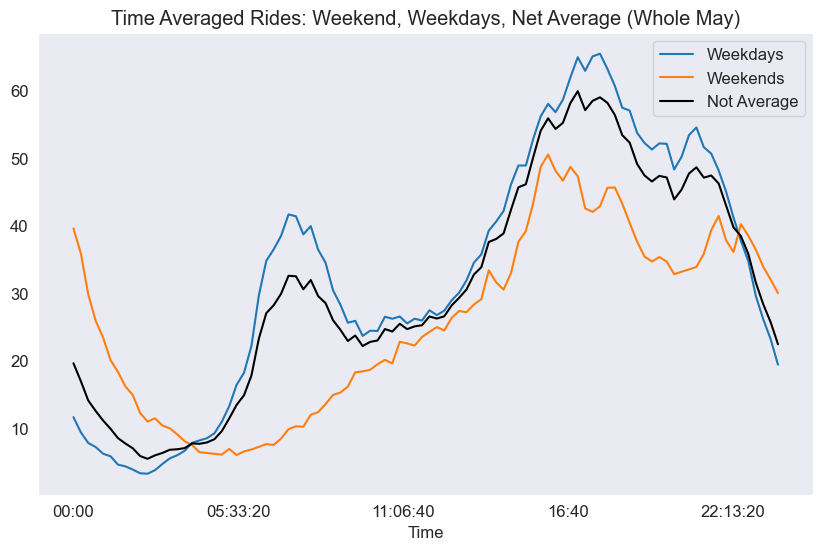

In [58]:
plt.figure(figsize=(10,6))
weekdays_weekends.plot(ax=plt.gca())
weekly_data.T.mean().plot(ax=plt.gca(),c ='black', label='Not Average')
plt.title('Time Averaged Rides: Weekend, Weekdays, Net Average (Whole May)')
plt.legend()
plt.show()

#### Observation 6: The plot clearly shows - In early morning, weekends have more rides. This makes sense as people often go out at night during the weekends.

The number of rides around 8 AM is less on weekends, but more on weekdays as it is usually the time when people goto work. Also, in the weekends, there is a surge in the number of evening rides as people return from work.

**With this, we finish our analysis of our Uber Pickups NYC Data.**

### On what date did we see the most number of uber pickups

In [5]:
import pandas as pd
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])
pickup_counts_by_date = uber_data['Date/Time'].dt.date.value_counts()
date_with_heighest_pickups = pickup_counts_by_date.idxmax()
print("Date with heighest number of uber pickups :", date_with_heighest_pickups)



Date with heighest number of uber pickups : 2014-05-16


### How Many Uber pickups were made on the date with the highest number of pickups

In [7]:
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])
pickup_counts_by_date = uber_data['Date/Time'].dt.date.value_counts()
date_with_heighest_pickups = pickup_counts_by_date.idxmax()

heighest_date_uber_data = uber_data[uber_data['Date/Time'].dt.date == date_with_heighest_pickups]
pickup_count_heighest_date = len(heighest_date_uber_data)

print("Number of Uber pickups on the date with the heighest number of pickups:", pickup_count_heighest_date)

Number of Uber pickups on the date with the heighest number of pickups: 32493


### How many Unique TLC base companies are affiliated with the Uber Pickups in the dataset

In [8]:
unique_base_companies = uber_data['Base'].nunique()

print("Number of unique TLC base companies affiliated with uber pickups :", unique_base_companies)

Number of unique TLC base companies affiliated with uber pickups : 5


### Which TLC base company had heighest number of pickups

In [9]:
pickup_counts = uber_data['Base'].value_counts()
company_with_heighest_pickups = pickup_counts.idxmax()

print("TLC base company with heighest number of pickups :", company_with_heighest_pickups)

TLC base company with heighest number of pickups : B02598


### How many Uber pickups were made at each unique TLC base company

In [10]:
pickup_counts = uber_data['Base'].value_counts()

print("Number of Uber pickups made at each unique TLC base company:")
print(pickup_counts)

Number of Uber pickups made at each unique TLC base company:
Base
B02598    260549
B02682    222883
B02617    122734
B02512     36765
B02764      9504
Name: count, dtype: int64


### Can you determine busiest time of day for uber pickups based on Date/Time column

In [16]:
uber_data['Hour'] = pd.to_datetime(uber_data['Date/Time']).dt.hour

# Group by hour and count the number of pickups
pickup_counts_by_hour = uber_data['Hour'].value_counts()

# Find the hour with the highest number of pickups
busiest_hour = pickup_counts_by_hour.idxmax()

print("The busiest time of day for Uber pickups is:", busiest_hour, "o'clock")


The busiest time of day for Uber pickups is: 17 o'clock


### Creating a visualization to represnt the number of uber pickups over time

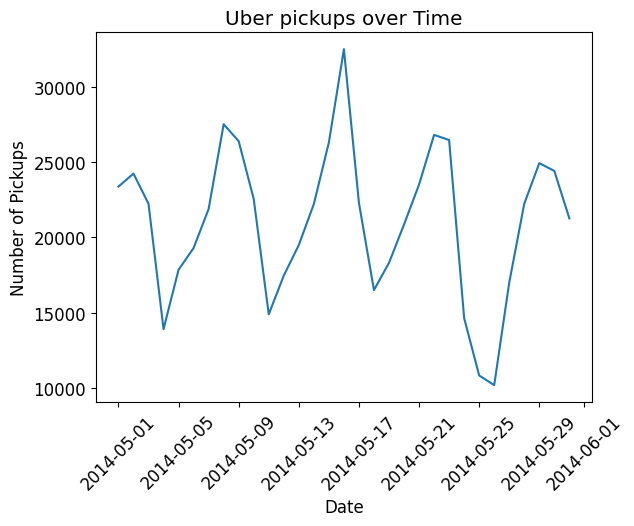

In [19]:
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])
pickup_counts_by_date = uber_data['Date/Time'].dt.date.value_counts().sort_index()

plt.plot(pickup_counts_by_date.index, pickup_counts_by_date.values)
plt.xlabel('Date')
plt.ylabel('Number of Pickups')
plt.title("Uber pickups over Time")
plt.xticks(rotation=45)
plt.show()

### Creating a Scatterplot to visualize the distribution of Uber pickups based on latitude and longitude

In [23]:
metro_art_coordinates = (40.7794, -73.9632 )
df = folium.Map(location=metro_art_coordinates, zoom_start=10)
folium.Marker(metro_art_coordinates, popup ="Metropolitan Museum").add_to(df)
Lat_Lon = df[['Lat','Lon']].to_numpy()
folium.plugins.HeatMap(Lat_Lon,radius =10).add_to(df)
display(df)

TypeError: 'Map' object is not subscriptable